## Загрузка библиотек

In [1]:
import pandas as pd
import warnings
import seaborn as sns
import matplotlib.pyplot as plt

from pandas_profiling import ProfileReport

sns.set(style="darkgrid")
warnings.filterwarnings(action='once')
sns.set(rc={'figure.figsize':(11.7,8.27)})

/home/fvelikonivcev/miniconda3/envs/ml/lib/python3.8/site-packages/seaborn/rcmod.py:400: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(mpl.__version__) >= "3.0":
/home/fvelikonivcev/miniconda3/envs/ml/lib/python3.8/site-packages/setuptools/_distutils/version.py:351: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)


## Загрузка данных

### Задание 1 (0.5 балла)

#### Решение:

In [2]:
def read_covid_dataset(path_to_csv, y=None):
    # Возвращает пару из X и y. X - массив векторов. y - соответствующие векторам метки
    X = pd.read_csv(path_to_csv)
    return X, y


def read_hr_dataset(path_to_csv):
    # Возвращает пару из X и y. X - массив векторов. y - соответствующие векторам метки
    data = pd.read_csv(path_to_csv)
    X = data.drop("target", axis="columns")
    y = data["target"]    
    return X, y

In [3]:
COVID_DATA_PATH = "hw_EDA_data/covid.csv"
HR_DATA_PATH = "hw_EDA_data/hr.csv"

In [4]:
X_covid, _ = read_covid_dataset(COVID_DATA_PATH)
X_hr, y_hr = read_hr_dataset(HR_DATA_PATH)

## EDA

### Задание 2 (3.5 балла)

#### 1. (0.5 балла)

Для числовых признаков постройте распределения признаков. Для категориальных признаков выведите статистику по количеству значений признака.

__Проверим, какие признаки являются числовыми:__

In [5]:
X_hr.dtypes

enrollee_id                 int64
city                       object
city_development_index    float64
gender                     object
relevent_experience        object
enrolled_university        object
education_level            object
major_discipline           object
experience                 object
company_size               object
company_type               object
last_new_job               object
training_hours              int64
dtype: object

### Построим гистограммы распределения для целоцисленных признаков:

In [6]:
# city_development_index
# training_hours
# enrolle-id также является численной, но не отражает характер данных
def show_numerical_features_dist(dataset):
    fig, axs = plt.subplots(ncols=3, )
    
    sns.histplot(dataset["city_development_index"], ax=axs[0])
    
    sns.histplot(dataset["training_hours"], ax=axs[1]).set(ylabel=None)
    
    sns.histplot(dataset["enrollee_id"], ax=axs[2]).set(ylabel=None)

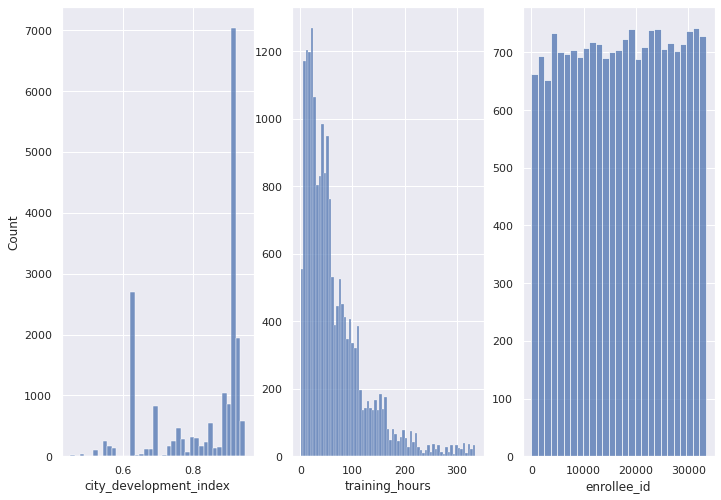

In [7]:
show_numerical_features_dist(X_hr)

### Статистика по количеству значений для категориальных признаков:

In [8]:
def show_nonnumeric_values(dataset):
    categorical_variables = dataset.columns[dataset.dtypes == "object"]
    categorical_variables_number = len(categorical_variables)
    print(categorical_variables)
    a = dataset[categorical_variables].copy()
    return ProfileReport(a)

In [9]:
s = show_nonnumeric_values(X_hr)
s

Index(['city', 'gender', 'relevent_experience', 'enrolled_university',
       'education_level', 'major_discipline', 'experience', 'company_size',
       'company_type', 'last_new_job'],
      dtype='object')


/home/fvelikonivcev/miniconda3/envs/ml/lib/python3.8/site-packages/pandas_profiling/profile_report.py:407: DeprecationWarning: Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display
  from IPython.core.display import display
/home/fvelikonivcev/miniconda3/envs/ml/lib/python3.8/site-packages/pandas_profiling/report/presentation/flavours/widget/duplicate.py:1: DeprecationWarning: Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display
  from IPython.core.display import display
/home/fvelikonivcev/miniconda3/envs/ml/lib/python3.8/site-packages/pandas_profiling/report/presentation/flavours/widget/sample.py:1: DeprecationWarning: Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display
  from IPython.core.display import display


Summarize dataset:   0%|          | 0/23 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

#### 2. (0.5 балла)
Удалите все строки, где есть хотя бы одно пропущенное значение признака. Насколько сильно уменьшился размер датасета? Как изменились распределения признаков/статистика по количеству значений признаков?

In [10]:
print(f'Исходный размер датасета hr {X_hr.shape[0]}')

Исходный размер датасета hr 19158


In [11]:
X_hr_dropna = X_hr.dropna()

In [12]:
print(f'Pазмер датасета hr без NaN {X_hr_dropna.shape[0]}')

Pазмер датасета hr без NaN 8955


In [13]:
print(f"Датасет уменьшился на {(1 - X_hr_dropna.shape[0] / X_hr.shape[0]) * 100} процентов")

Датасет уменьшился на 53.25712496085187 процентов


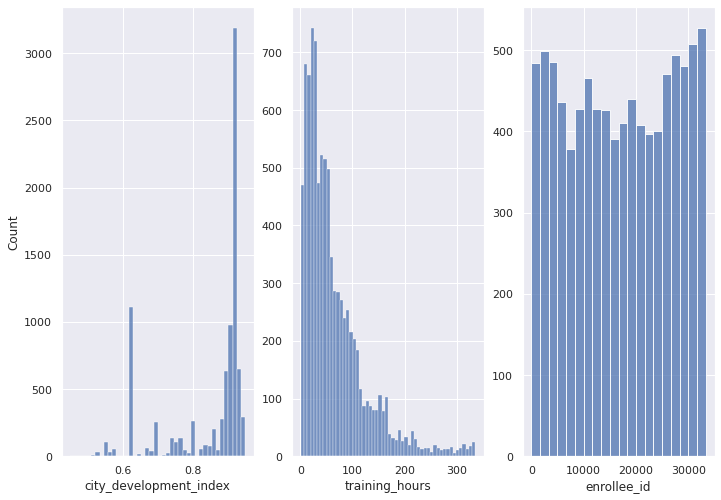

In [14]:
show_numerical_features_dist(X_hr_dropna)

In [15]:
s = show_nonnumeric_values(X_hr_dropna)
s

Index(['city', 'gender', 'relevent_experience', 'enrolled_university',
       'education_level', 'major_discipline', 'experience', 'company_size',
       'company_type', 'last_new_job'],
      dtype='object')


/home/fvelikonivcev/miniconda3/envs/ml/lib/python3.8/site-packages/pandas_profiling/profile_report.py:407: DeprecationWarning: Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display
  from IPython.core.display import display


Summarize dataset:   0%|          | 0/24 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Сравнение распределений признаков до и после удаления nan

_Ваш ответ_ - характер распределения числовых признаков остался прежним, однако, количество наблюдений заметно уменьшилось (к примеру, значение "1" в признаке `last new job` всё еще является самым частым, но встречается 3838 в сравнении с 8040 в исходном датасете.

#### Наглядная демонстрация уменьшения датасета:

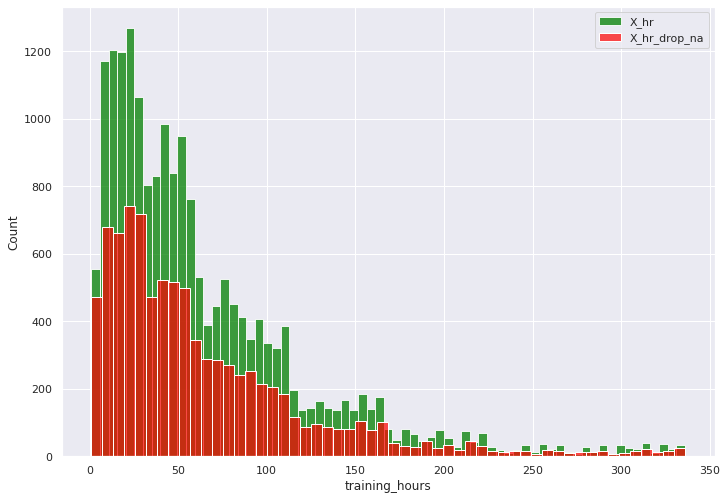

In [16]:
plt.figure()
sns.histplot(X_hr["training_hours"], label="X_hr", color="green")
sns.histplot(X_hr_dropna["training_hours"], color="red", label="X_hr_drop_na", alpha=0.7)
plt.legend()
plt.show()

Давайте попробуем избежать сокращения размера датасета.

#### 3.  (1 балл)
Для числовых признаков заполните пропущенные данные средним/медианой/модой данного признака. Объясните свой выбор. (Часть строк с NaN значениями можно удалить, если размер датасета уменьшится <15%)

### Объяснение
так как распределения признаков смещены, а медиана более устойчива к смещению и выбросам, применим заполнение nan медианным значением

In [17]:
import numpy as np
from sklearn.impute import SimpleImputer

/home/fvelikonivcev/miniconda3/envs/ml/lib/python3.8/site-packages/sklearn/utils/multiclass.py:14: DeprecationWarning: Please use `spmatrix` from the `scipy.sparse` namespace, the `scipy.sparse.base` namespace is deprecated.
  from scipy.sparse.base import spmatrix
/home/fvelikonivcev/miniconda3/envs/ml/lib/python3.8/site-packages/sklearn/utils/optimize.py:18: DeprecationWarning: Please use `line_search_wolfe2` from the `scipy.optimize` namespace, the `scipy.optimize.linesearch` namespace is deprecated.
  from scipy.optimize.linesearch import line_search_wolfe2, line_search_wolfe1
/home/fvelikonivcev/miniconda3/envs/ml/lib/python3.8/site-packages/sklearn/utils/optimize.py:18: DeprecationWarning: Please use `line_search_wolfe1` from the `scipy.optimize` namespace, the `scipy.optimize.linesearch` namespace is deprecated.
  from scipy.optimize.linesearch import line_search_wolfe2, line_search_wolfe1


In [18]:
imputer = SimpleImputer(missing_values=np.nan, strategy="median")

num_columns = X_hr.columns[(X_hr.dtypes == "int64") | (X_hr.dtypes == "float64")]

imputed_columns = imputer.fit_transform(X_hr[num_columns])
X_hr[num_columns] = imputed_columns

Небольшая проверка:

In [19]:
X_hr[num_columns].isna().sum().sum() # суммирование по булевой маске, которая истинна, если значение истинно

0

#### 4.  (1 балл)
Для категориальных признаков заполните пропущенные значения самой встречающейся категорией или создайте отдельную категорию пропущенных значений. Объясните свой выбор. (Часть строк с NaN значениями можно удалить, если размер датасета уменьшится <15%)

#### Ответ
Проверим количество пропущенных значений (оно окажется довольно большим - см. следующую ячейку). Исходя из большого количества пропущенных значений, нельзя заменять их на самый частый класс, так как это приведет к сильному сдвигу информации и неправильной картине данных. Выход - __создание дополнительной категории пропущенных значений `missing` в колонках__

In [20]:
X_hr.isna().sum()

enrollee_id                  0
city                         0
city_development_index       0
gender                    4508
relevent_experience          0
enrolled_university        386
education_level            460
major_discipline          2813
experience                  65
company_size              5938
company_type              6140
last_new_job               423
training_hours               0
dtype: int64

In [21]:
y_hr.isnull().sum()

0

In [22]:
def fill_na(X, y, strategy="constant", fill_value="missing"):
    # y не имеет пропущенных значений
    categorical_imputer = SimpleImputer(strategy=strategy, fill_value=fill_value)
    
    categorical_variables = X.columns[X.dtypes == "object"]
    
    categorical_columns_imputed = categorical_imputer.fit_transform(X[categorical_variables])
    X[categorical_variables] = categorical_columns_imputed
    
    return X, y

In [23]:
X_hr_fill, y_hr_fill = fill_na(X_hr, y_hr)

Проверка:


In [24]:
X_hr_fill.isna().sum().sum()

0

#### 5.  (0.5 балла)
Как изменились распределения признаков/статистика по количеству значений признаков после заполнения пропущенных данных?

In [25]:
ProfileReport(X_hr_fill)

/home/fvelikonivcev/miniconda3/envs/ml/lib/python3.8/site-packages/pandas_profiling/profile_report.py:407: DeprecationWarning: Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display
  from IPython.core.display import display


Summarize dataset:   0%|          | 0/26 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

#### Ответ
как видно из визуализаций, во многих категориальных признаках признак "missing" занимает небольшое количество позиций, исключением является признак `company_size`, где пропущенных значений 30% от общего числа. Также в признаке `graduation_type` категория "missing" представлена второй по величине (30%), и в `company_type` - 30%. Касаемо числовых признаков - закон распределения сохранён. Модели машинного обучения придётся учиться на пропущенных данных.

### Задание 3  (1 балл)

Выполните задание для датасета _covid_.

1. Найдите страну, для которой в датасете присутствует 46 дат со статистикой по вакцинации.
2. Постройте для этой страны график зависимости _total_vaccinations_ от _date_.
3. Заполните пропущенные данные о _total_vaccinations_ для этой страны. Объясните свой выбор.

In [26]:
countries = X_covid["country"].unique()
values_dates = X_covid.groupby("country")["date"].value_counts(dropna=False)

countries_entries = {len(values_dates[c]): c for c in countries}

country = countries_entries[46]

In [27]:
print(country)

Bahrain


In [28]:
X_country = X_covid[X_covid["country"] == country]

Построим график, чтобы понять вид зависимости

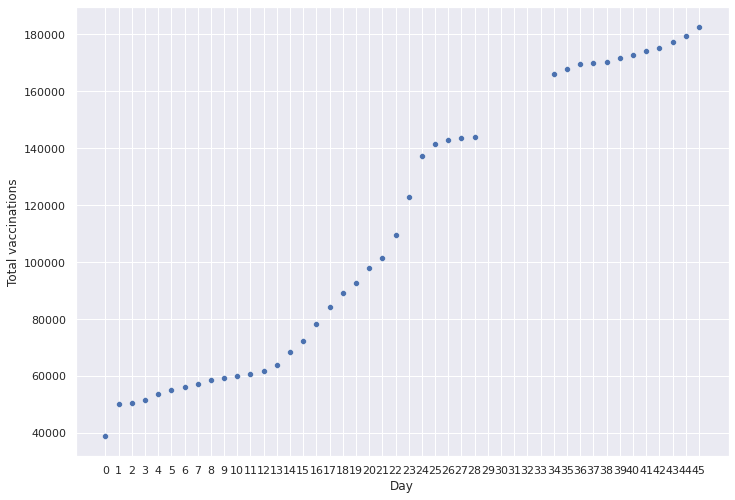

In [29]:
s = sns.scatterplot(data=X_country, 
           x="date",
           y="total_vaccinations")
s.set_xticklabels((range(X_country.shape[0])))
s.set(xlabel="Day", ylabel="Total vaccinations")
plt.show()

Как видно, наблюдений не хватает, однако, прослеживается зависимость. Можем предположить, что функция количества вакцинированных от количества прошедших дней монотонно возрастает, так как с каждым днём количество вакцинированных растёт. Тогда мы можем предугадать промежуточные значения функции в недостающих точках, предполагая, что количество вакцинированных росло похожим образом, описанным на графике

In [30]:
# экстраполиуем результаты на промежуточные значения, добавим нелинейное значение (так как видно, что характер зависимости близок к полиномиальному):
X_country["x"] = np.arange(X_country.shape[0])


vaccinations_dataset = X_country[["x", "total_vaccinations"]].rename(columns={"total_vaccinations": "y"})
vaccinations_dataset["x^2"] = vaccinations_dataset["x"] ** 2
vaccinations_dataset["x^3"] = vaccinations_dataset["x"] ** 3
vaccinations_dataset["x_sqrt"] = np.sqrt(vaccinations_dataset["x"])

/tmp/ipykernel_68320/3443119631.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X_country["x"] = np.arange(X_country.shape[0])


In [31]:
from sklearn.linear_model import LinearRegression


regression_dataset = vaccinations_dataset[~vaccinations_dataset["y"].isnull()]

linear_reg = LinearRegression()
X = regression_dataset.drop("y", axis="columns").values
y = regression_dataset["y"].values
linear_reg.fit(X, y)



dataset_for_prediction = vaccinations_dataset[vaccinations_dataset["y"].isnull()]
predicted = linear_reg.predict(dataset_for_prediction.drop("y", axis="columns").values)

In [32]:
dataset_for_prediction["y"] = predicted
predicted_values_dataset = pd.concat([regression_dataset, dataset_for_prediction]).sort_values(by="x")

/tmp/ipykernel_68320/544638111.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset_for_prediction["y"] = predicted


__Визуализируем__

In [33]:
dataset_for_prediction

,x,y,x^2,x^3,x_sqrt
107,29,147305.380363,841,24389,5.385165
108,30,151846.992106,900,27000,5.477226
109,31,156149.051874,961,29791,5.567764
110,32,160176.822154,1024,32768,5.656854
111,33,163895.476230,1089,35937,5.744563


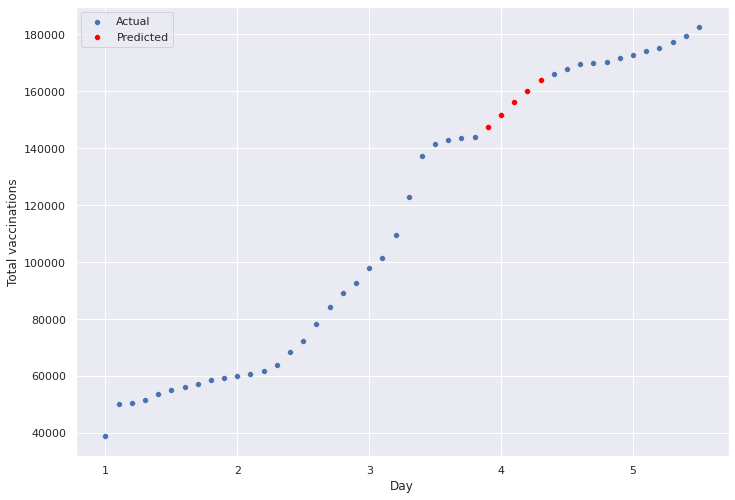

In [34]:
# применим предсказанные значения к нашему тренду и визуализируем:
plt.figure()
sns.scatterplot(data=predicted_values_dataset, 
           x="x",
           y="y", label="Actual").set_xticklabels((range(predicted_values_dataset.shape[0])))
sns.scatterplot(data=dataset_for_prediction, x="x", y="y", color="red", label="Predicted")
plt.xlabel("Day")
plt.ylabel("Total vaccinations")
plt.legend()
plt.show()

__Как видно, такая картина вполне вписывается в реальную ситуацию__

### Задание  4 (0.5 балла)
Выполните задание для датасета _hr_.

Есть ли в данных выбросы? Если да, то скажите, какие и почему Вы считаете их выбросами?


/home/fvelikonivcev/miniconda3/envs/ml/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


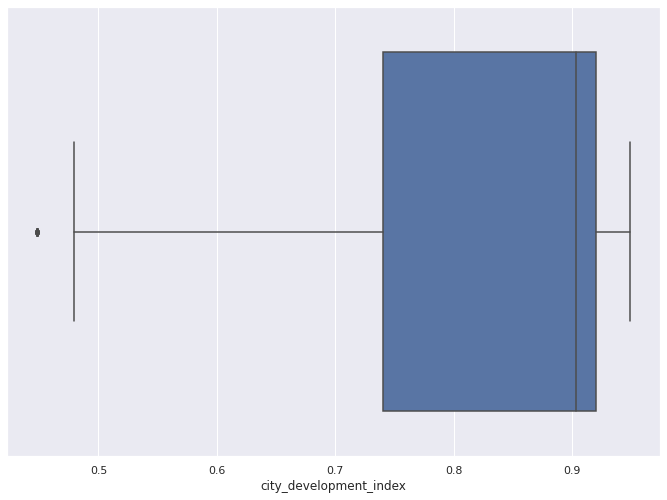

In [35]:
X_hr_raw, y_hr_raw = read_hr_dataset("hw_EDA_data/hr.csv")

plt.figure()
sns.boxplot(X_hr_raw["city_development_index"])
plt.show()

Возможно, выбросом в признаке `city_development_index` является минимальное значение, так как оно много меньше типичных значений:

In [36]:
print(f"Possible outluer: {X_hr_raw['city_development_index'].min()}")

Possible outluer: 0.4479999999999999


/home/fvelikonivcev/miniconda3/envs/ml/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


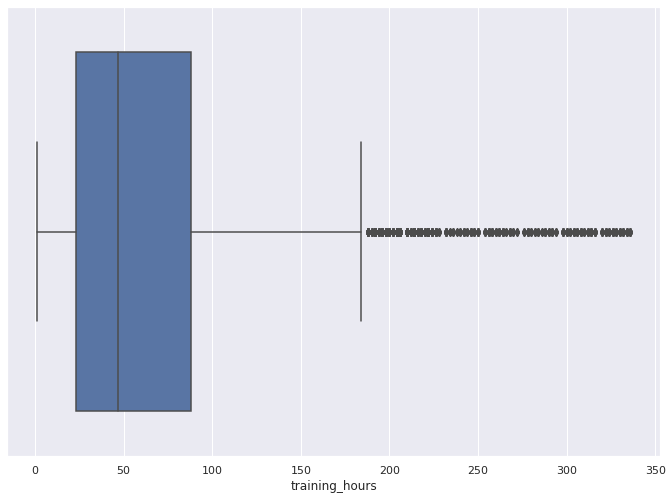

In [37]:
plt.figure()
sns.boxplot(X_hr_fill["training_hours"])
plt.show()

__Ответ:__ Присутствует выброс в `city_development_index`, о наличии выбросов в `training_hours` говорить сложно, так как имеется общая тенденция данных формировать длинный хвост вправо. О выбросах в категориальных признаках говорить не имеет смысла, могут быть лишь неправильно заполненные признаки/ошибки в записи, что приводит к наличию малочисленной категории. Pandas profiler опровергает наличие таких признаков, так как нет категории в признаке с долей меньше 1 %.

### Задание  5 (1 балл)
Выполните задание для датасета _hr_.

Закодируйте категориальные признаки при помощи One-hot encoding/Label encoding/Frequency encoding. Объясните свой выбор. (Обратите внимание, что некоторые категориальные признаки предполагают ранжирование в своих значениях)


__Ответ:__ # закодируем one-hot призники, где не важно ранжирование, и там, где важно - label-encoding, для признака `city` используем frequency-encoding, так как у данного признака имеется большое количество дискретных значений, а значит, one-hot-encoding не подойдёт (большой расход памяти), label-encoding - тоже, так как города не ранжируются между собой (_собственное предположение_)

In [38]:
from sklearn.preprocessing import LabelEncoder
from itertools import chain

def encode(X):
    X_encode = X.copy()
    freq_encoded_city = X_encode.groupby("city").size() / len(X_hr)
    X_encode["city"] = X_encode["city"].apply(lambda x: freq_encoded_city[x])
    
    gender_dummies = pd.get_dummies(X_encode["gender"], prefix="gender")
    relevant_exp_dummies = pd.get_dummies(X_encode["relevent_experience"], prefix="rel_exp")
    major_discip_dummies = pd.get_dummies(X_encode["major_discipline"], prefix="maj_discip")
    company_type = pd.get_dummies(X_encode["company_type"], prefix="company_type")
    
    
    univ_encoder = LabelEncoder().fit(['missing', 'no_enrollment', 'Part time course', 'Full time course'])
    enrolled_encoded = univ_encoder.transform(X_encode["enrolled_university"].values)
    X_encode["enrolled_university"] = enrolled_encoded
    
    education_encoder = LabelEncoder().fit(['missing', 'Primary School', 'High School', 
                                            'Graduate', 'Masters', 'Phd'])
    education_encoded = education_encoder.transform(X_encode["education_level"].values)
    X_encode["education_level"] = education_encoded

    exp_encoder = LabelEncoder().fit([
        'missing', '<1', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', 
        '11', '12', '13', '14', '15', '16', '17', '18', '19','20','>20'])
    exp_encoded = exp_encoder.transform(X_encode["experience"].values)
    X_encode["experience"] = exp_encoded
    
    
    
    company_size_encoder = LabelEncoder().fit(['missing', '<10', '10/49', '50-99', '100-500', '500-999', 
                                               '1000-4999', '5000-9999', '10000+'])
    
    company_size_encoded = company_size_encoder.transform(X_encode["company_size"].values)
    X_encode["company_size"] = company_size_encoded
    
    
    X_encode = pd.concat([X_encode, gender_dummies, relevant_exp_dummies, major_discip_dummies, company_type], axis=1)    

    
    
    
    return X_encode.select_dtypes(exclude=["object"])

In [39]:
X_hr_encode = encode(X_hr_fill)
X_hr_encode

,enrollee_id,city,city_development_index,enrolled_university,education_level,experience,company_size,training_hours,gender_Female,gender_Male,...,maj_discip_Other,maj_discip_STEM,maj_discip_missing,company_type_Early Stage Startup,company_type_Funded Startup,company_type_NGO,company_type_Other,company_type_Public Sector,company_type_Pvt Ltd,company_type_missing
0,8949.0,0.227320,0.920,3,0,21,8,36.0,0,1,...,0,1,0,0,0,0,0,0,0,1
1,29725.0,0.003549,0.776,3,0,6,4,47.0,0,1,...,0,1,0,0,0,0,0,0,1,0
2,11561.0,0.141038,0.624,0,0,15,8,83.0,0,0,...,0,1,0,0,0,0,0,0,0,1
3,33241.0,0.002819,0.789,2,0,20,8,52.0,0,0,...,0,0,0,0,0,0,0,0,1,0
4,666.0,0.006681,0.767,3,2,21,4,8.0,0,1,...,0,1,0,0,1,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19153,7386.0,0.007882,0.878,3,0,5,8,42.0,0,1,...,0,0,0,0,0,0,0,0,0,1
19154,31398.0,0.227320,0.920,3,0,5,8,52.0,0,1,...,0,1,0,0,0,0,0,0,0,1
19155,24576.0,0.227320,0.920,3,0,21,4,44.0,0,1,...,0,1,0,0,0,0,0,0,1,0
19156,5756.0,0.009135,0.802,3,1,20,5,97.0,0,1,...,0,0,1,0,0,0,0,0,1,0


### Задание  6 (1 балл)
Выполните задание для датасета _hr_.




#### 1.  (1 балл)
Реализуйте функцию undersampling

#### 2.  (1 балл)
Реализуйте функцию oversampling

In [40]:
def undersampling(X, y):
    # random undersampling
    y_values_amount = y.value_counts()
    rare_class, rare_class_amount = y_values_amount.index[-1], y_values_amount.iloc[-1]
    
    rare_class_indices = y[y == rare_class].index
    major_class_indices = y[~(y == rare_class)].index
    
    random_indices_for_undersampling = np.random.choice(major_class_indices, size=rare_class_amount)
    
    X_major_under = X.iloc[random_indices_for_undersampling].copy()
    X_rare_under = X.iloc[rare_class_indices].copy()
    
    y_major_under = y.iloc[random_indices_for_undersampling].copy()
    y_rare_under = y.iloc[rare_class_indices].copy()
    
    
    X_under = pd.concat([X_major_under, X_rare_under])
    y_under = pd.concat([y_major_under, y_rare_under])
    
    rare = y_under.value_counts().iloc[1]
    major = y_under.value_counts().iloc[0]
    assert major  == rare, f"Sizes of datasets after undersamplig are still not the same - major {major} vs. rare {rare}"

    return X_under, y_under

def oversampling(X, y):
    # Возвращает данные, сбалансированные методом undersampling
    y_values_amount = y.value_counts()
    rare_class = y_values_amount.index[-1]
    rare_class_amount = y_values_amount.iloc[-1]
    
    times_to_oversample_integer = (y_values_amount[0] // rare_class_amount) - 1
    times_to_oversample_residual = y_values_amount[0] % rare_class_amount
    
    rare_class_indices = y[y == rare_class].index
    major_class_indices = y[~(y == rare_class)].index
    
    
    
    X_over = X.copy()
    y_over = y.copy()

    for i in range(times_to_oversample_integer):

        X_over = pd.concat([X_over, X.iloc[rare_class_indices]])
        y_over = pd.concat([y_over, y.iloc[rare_class_indices]])
    else:
        
        random_rare_indices = np.random.choice(rare_class_indices, times_to_oversample_residual)
        X_over = pd.concat([X_over, X.iloc[random_rare_indices]])
        y_over = pd.concat([y_over, y.iloc[random_rare_indices]])

    rare = y_over.value_counts().iloc[1]
    major = y_over.value_counts().iloc[0]

    assert major  == rare, f"Sizes of datasets after undersamplig are still not the same - major {major} vs. rare {rare}"
    return X_over, y_over

In [41]:
X_hr_under, y_hr_under = undersampling(X_hr_encode, y_hr_fill)

X_hr_over, y_hr_over = oversampling(X_hr_encode, y_hr_fill)

#### 3.  (1 балл)
Используйте _SMOTE_ для балансировки датасета.

Помимо методов _undersampling_ и _oversampling_ существует подход, генерирующий элементы класса-меньшинства, похожие на уже присутствующие в выборке данных. Такой метод называется _Synthetic Minority Oversampling Technique_ (SMOTE). 

Метод _SMOTE_ , реализованный в библиотеке `imblearn`, генерирует синтетические примеры при помощи __k-nearest neighbor__ алгоритма (подробнее об этом алгоритме будет рассказано на лекции).

In [42]:
from imblearn.over_sampling import SMOTE

smote = SMOTE(random_state=42)
X_hr_SMOTE, y_hr_SMOTE = smote.fit_resample(X_hr_encode, y_hr) 

#### 4. (0.5 балла)
Как изменились распределения признаков при различных тактиках балансирования датасета?

### Проведём анализ на over-датасете:

In [43]:
ProfileReport(X_hr_over)

/home/fvelikonivcev/miniconda3/envs/ml/lib/python3.8/site-packages/pandas_profiling/profile_report.py:407: DeprecationWarning: Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display
  from IPython.core.display import display


Summarize dataset:   0%|          | 0/42 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### Проведём анализ на under-датасете:

In [45]:
ProfileReport(X_hr_under)

/home/fvelikonivcev/miniconda3/envs/ml/lib/python3.8/site-packages/pandas_profiling/profile_report.py:407: DeprecationWarning: Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display
  from IPython.core.display import display


Summarize dataset:   0%|          | 0/42 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### Проведём анализ на SMOTE-датасете

In [46]:
ProfileReport(X_hr_SMOTE)

/home/fvelikonivcev/miniconda3/envs/ml/lib/python3.8/site-packages/pandas_profiling/profile_report.py:407: DeprecationWarning: Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display
  from IPython.core.display import display


Summarize dataset:   0%|          | 0/41 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Построим гистограммы для сравнения распределений признаков

In [47]:
def compare_datasets(by):
    plt.figure()
    sns.histplot(X_hr_SMOTE[by], label="SMOTE", color="green")
    sns.histplot(X_hr_under[by], label="under", color="blue", alpha=0.6)
    sns.histplot(X_hr_over[by], label="over", color="orange", alpha=0.4)
    sns.histplot(X_hr_encode[by], label="raw", color="red", alpha=0.2)
    plt.legend()
    plt.show()

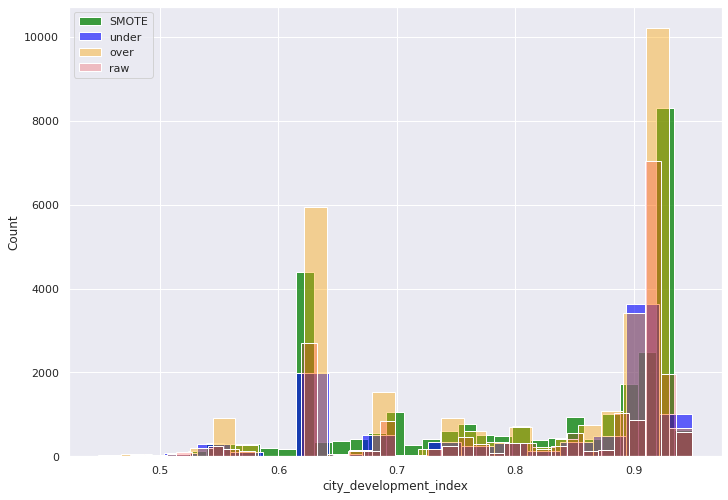

In [48]:
compare_datasets(by="city_development_index")

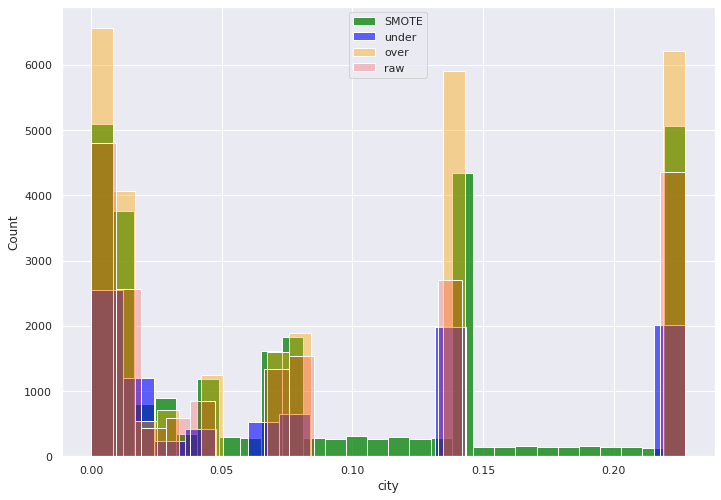

In [49]:
compare_datasets(by="city")

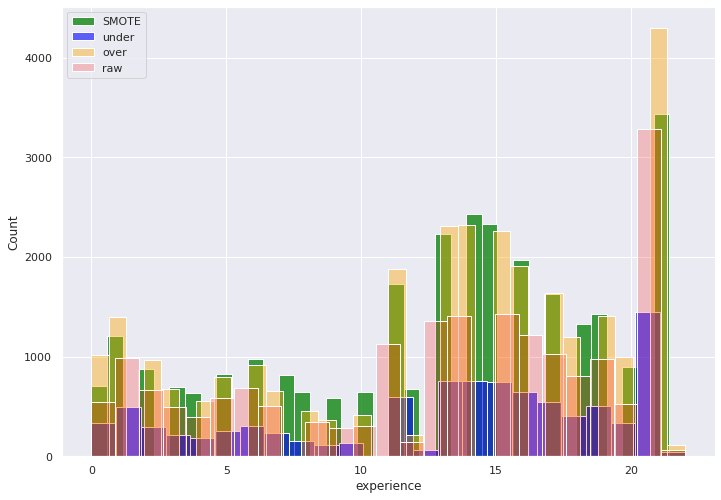

In [50]:
compare_datasets(by="experience")

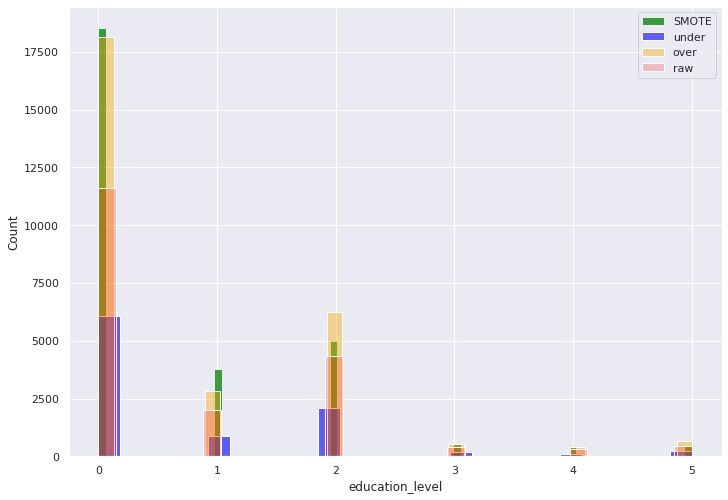

In [51]:
compare_datasets(by="education_level")

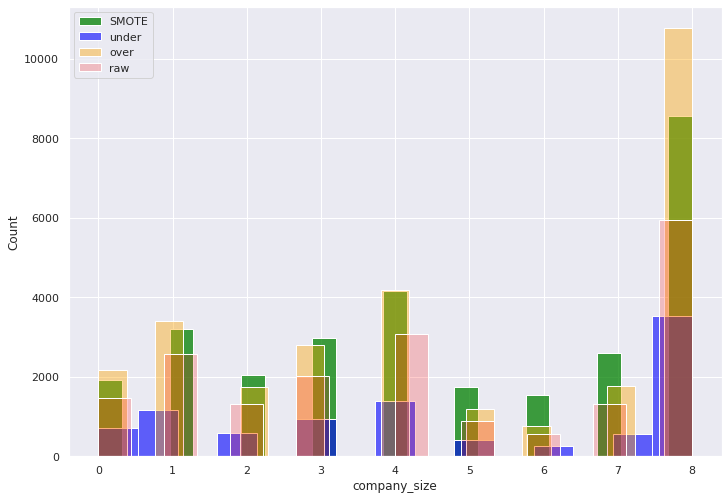

In [52]:
compare_datasets(by='company_size')

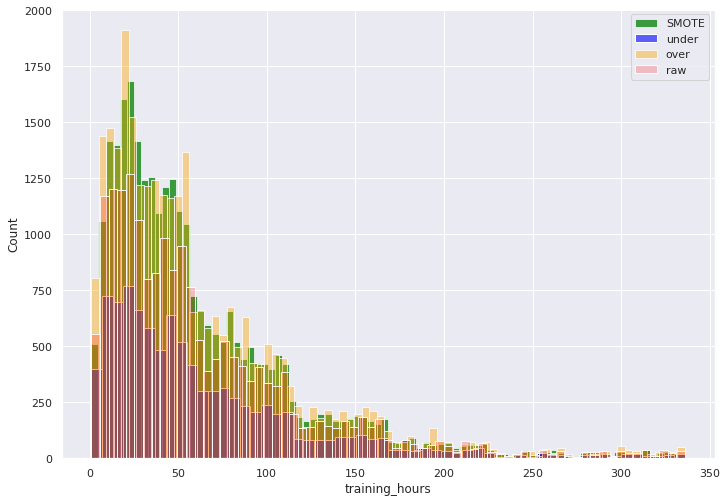

In [53]:
compare_datasets(by="training_hours")

Как видно, на некоторых признаках метод SMOTE сгенерировал значения, которых не было в изначальной выборке (`city_development_index`, `city`), при этом уложившись в изначальный характер распределения признаков. Остальные методы показали ожидаемые результаты - все методы на количественных и дискретных категориальных значениях имеют схожие распределения, значений в over-sampling-датасете больше количественно, в under-sampling-датасете, очевидно, меньше по количеству, распределение сохраняется.

Что же касается качественных признаков, их соотношение остаётся прежним в каждом из вариантов сэмплинга, что видно из отчёта `ProfileReport`.